# Artificial Curiosity: Intrinsic Curiosity in Machines too!

## 1. Import dependencies

In [1]:
import torch
import numpy as np

from environments import SUPPORTED_ENVIRONMENTS, make_environment
from networks import ActorCritic, IntrinsicCuriosityModule
from utils import Recorder, Memory, load_checkpoint

## 2. Build environments and recorders

In [2]:
print(SUPPORTED_ENVIRONMENTS)

['Pong', 'Breakout', 'SuperMarioBros level 1', 'SuperMarioBros level 2']


In [3]:
pong = make_environment('Pong')
breakout = make_environment('Breakout')
mario_level_1 = make_environment('SuperMarioBros level 1')
mario_level_2 = make_environment('SuperMarioBros level 2')

recorder_1 = Recorder()
recorder_2 = Recorder()

## 3. Build a random agent


![RL framework](img/rl.png)
_<center>source: Richard S. Sutton and Andrew G. Barto, "Reinforcement Learning: An Introduction"</center>_

In [15]:
class RandomAgent:
    
    def play(self, environment, max_games=1, max_steps=500, recorder=None):
        
        # Reset environment
        observation = environment.reset()
        
        # Initialize infos and recorder
        n_games, n_steps = 0, 0
        current_game_infos = {'game': 1, 'reward': 0, 'game_duration': 0}
        if recorder is not None:
            recorder.reset()
            recorder.record(environment)

        # Main loop
        while (n_steps < max_steps) and (n_games < max_games):
            
            # Interact with environment
            action = environment.action_space.sample()
            observation, extrinsic_reward, is_game_over, infos = environment.step(action)
            
            # Update infos and recorder
            n_steps += 1
            current_game_infos['reward'] += extrinsic_reward
            current_game_infos['game_duration'] += 1
            if recorder is not None:
                recorder.record(environment)
            
            if is_game_over:
                # Update infos
                n_games += 1
                print(current_game_infos)
                current_game_infos = {'game': n_games + 1, 'reward': 0, 'game_duration': 0}
                # Reset environment
                observation = environment.reset()
        
        # Stop recorder
        if recorder is not None:
            recorder.stop()

## 4. Run the random agent

Preparing the animation...


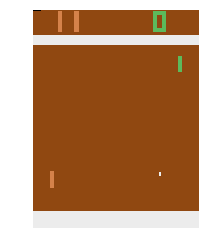

In [17]:
random_agent = RandomAgent()
random_agent.play(pong, max_games=1, max_steps=500, recorder=recorder_1)

In [18]:
recorder_1.replay()

## 5. Build a Smart Agent

![Actor Critic architecture](img/actor_critic.png)
_<center>source: Richard S. Sutton and Andrew G. Barto, "Reinforcement Learning: An Introduction"</center>_

In [19]:
class ActorCriticAgent:

    def __init__(self, num_actions, checkpoint=None):
        
        # Initialize network, optimizer and memory
        self.network, self.trainable_parameters = self.init_network(num_actions)
        self.optimizer = torch.optim.Adam(self.trainable_parameters, lr=1e-4)
        self.memory = Memory()
        
        # Load pretrained model
        if checkpoint is not None:
            load_checkpoint(self.network, self.optimizer, checkpoint)

    def init_network(self, num_actions):
        
        # Initialize Actor-Critic
        network = {'actor_critic': ActorCritic(num_actions)}
        trainable_parameters = list(network['actor_critic'].parameters())
        return network, trainable_parameters

    def play(self, environment, max_games=1, max_steps=500, train=False, verbose=False, recorder=None):
        
        # Reset environment
        observation = environment.reset()
        
        # Initialize infos and recorder
        n_steps = 0
        n_games = 0
        current_game_infos = {'game': n_games + 1, 'reward': 0, 'game_duration': 0}
        if recorder is not None:
            recorder.reset()
            recorder.record(environment)

        # Main loop
        while (n_steps < max_steps) and (n_games < max_games):
            
            # Reset memory
            self.init_rollout(observation)
            
            for rollout_step in range(20):
                
                # Interact with environment
                value, log_policy, action = self.network['actor_critic'](observation)
                self.memory.append({'value': value, 'log_policy': log_policy, 'action': action})
                
                observation, extrinsic_reward, is_game_over, infos = environment.step(action.numpy()[0])
                
                reward = self.get_reward(observation, extrinsic_reward)
                self.memory.append({'reward': reward})

                # Update infos and recorder
                n_steps += 1
                current_game_infos['reward'] += extrinsic_reward
                current_game_infos['game_duration'] += 1
                if recorder is not None:
                    recorder.record(environment)

                if is_game_over:
                    # Update infos
                    n_games += 1
                    print(current_game_infos)
                    current_game_infos = {'game': n_games + 1, 'reward': 0, 'game_duration': 0}
                    # Reset environment
                    observation = environment.reset()
                    # Interrupt rollout
                    break
            
            self.end_rollout(observation, is_game_over)
            if verbose:
                print(current_game_infos)
            
            if train:
                # Update neural network
                loss = self.compute_loss()
                self.backpropagate(loss)

        if recorder is not None: recorder.stop()

    def init_rollout(self, observation):
        self.memory.reset()
        self.network['actor_critic'].detach_internal_state()

    def end_rollout(self, observation, is_game_over):
        if is_game_over:
            next_value = torch.Tensor([[0]])
            self.network['actor_critic'].reset_internal_state()
        else:
            next_value = self.network['actor_critic'](observation)[0].detach()
        self.memory.append({'value': next_value})

    def get_reward(self, observation, extrinsic_reward):
        return np.clip(extrinsic_reward, -1, 1)

    def compute_loss(self):
        return self.network['actor_critic'].loss(self.memory)

    def backpropagate(self, loss, max_gradient_norm=40):
        self.optimizer.zero_grad()
        loss.backward()
        torch.nn.utils.clip_grad_norm_(self.trainable_parameters, max_gradient_norm)
        self.optimizer.step()

## 6. Run the Smart Agent

In [20]:
smart_mario_agent = ActorCriticAgent(num_actions=mario_level_1.action_space.n)

{'game': 1, 'reward': -1.2, 'game_duration': 20}
{'game': 1, 'reward': 5.0, 'game_duration': 40}
{'game': 1, 'reward': 4.133333333333333, 'game_duration': 60}
{'game': 1, 'reward': 3.9999999999999996, 'game_duration': 80}
{'game': 1, 'reward': 4.066666666666666, 'game_duration': 100}
{'game': 1, 'reward': 2.933333333333332, 'game_duration': 120}
{'game': 1, 'reward': 0.9333333333333322, 'game_duration': 140}
{'game': 1, 'reward': 2.5333333333333323, 'game_duration': 160}
{'game': 1, 'reward': 9.600000000000001, 'game_duration': 180}
{'game': 1, 'reward': 20.333333333333343, 'game_duration': 200}
{'game': 1, 'reward': 23.000000000000018, 'game_duration': 220}
{'game': 1, 'reward': 22.00000000000002, 'game_duration': 240}
{'game': 1, 'reward': 18.13333333333336, 'game_duration': 260}
{'game': 1, 'reward': 18.33333333333336, 'game_duration': 280}
{'game': 1, 'reward': 21.53333333333335, 'game_duration': 300}
{'game': 1, 'reward': 19.86666666666669, 'game_duration': 320}
{'game': 1, 'rewar

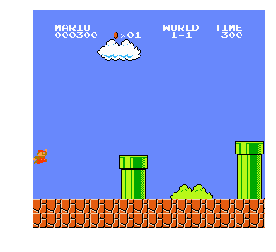

In [21]:
smart_mario_agent.play(mario_level_1, max_games=3, max_steps=500, verbose=True, recorder=recorder_1)

In [22]:
recorder_1.replay()

In [23]:
smart_mario_agent.play(mario_level_1, max_games=10, max_steps=1000000, train=True)

{'game': 1, 'reward': 26.53333333333333, 'game_duration': 978}
{'game': 2, 'reward': 32.333333333333286, 'game_duration': 816}
{'game': 3, 'reward': 46.73333333333311, 'game_duration': 677}
{'game': 4, 'reward': 37.933333333333294, 'game_duration': 225}
{'game': 5, 'reward': 47.33333333333324, 'game_duration': 372}
{'game': 6, 'reward': 41.13333333333332, 'game_duration': 152}
{'game': 7, 'reward': 40.39999999999999, 'game_duration': 134}
{'game': 8, 'reward': 15.799999999999999, 'game_duration': 40}
{'game': 9, 'reward': 16.266666666666673, 'game_duration': 32}
{'game': 10, 'reward': 72.66666666666664, 'game_duration': 394}


{'game': 1, 'reward': 41.66666666666664, 'game_duration': 103}
{'game': 2, 'reward': 47.266666666666616, 'game_duration': 235}
Preparing the animation...


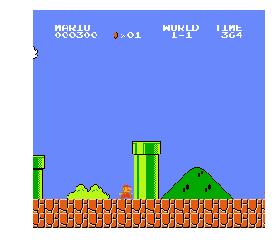

In [24]:
smart_mario_agent.play(mario_level_1, max_games=3, max_steps=500, recorder=recorder_1)

In [25]:
recorder_1.replay()

{'game': 1, 'reward': 204.4000000000004, 'game_duration': 272}
Preparing the animation...


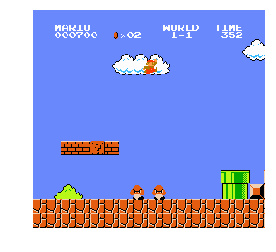

In [26]:
smart_mario_agent = ActorCriticAgent(num_actions=mario_level_1.action_space.n,
                                     checkpoint='models/smart_mario_agent_4M.tar')
smart_mario_agent.play(mario_level_1, max_games=3, max_steps=500, recorder=recorder_1)

In [27]:
recorder_1.replay()

## 7. Build a Curious Agent

![Intrinsic Curiosity Module architecture](img/icm.png)
_<center>source: Pathak et al., "Curiosity driven Exploration by Self-supervision Prediction" (2017)</center>_

In [33]:
class CuriousActorCriticAgent(ActorCriticAgent):

    def init_network(self, num_actions):
        network, trainable_parameters = super().init_network(num_actions)
        # Initialize Intrinsic Curiosity Module
        network['icm'] = IntrinsicCuriosityModule(num_actions)
        trainable_parameters += list(network['icm'].parameters())
        return network, trainable_parameters

    def init_rollout(self, observation):
        super().init_rollout(observation)
        # Encode the observation into features
        features = self.network['icm'].observation_encoder(observation)
        self.memory.append({'features': features})

    def end_rollout(self, observation, is_game_over):
        # Ignore information about the end of the game
        next_value = self.network['actor_critic'](observation)[0].detach()
        self.memory.append({'value': next_value})

    def get_reward(self, observation, extrinsic_reward):
        
        # Retrieve features and action from the previous step
        last_features = self.memory.get_last('features')
        last_action = self.memory.get_last('action')
        # Encode the observation into features
        features = self.network['icm'].observation_encoder(observation)
        
         # Try to find by yourself the inputs and outputs of these neural networks:
        predicted_features = self.network['icm'].forward_model(last_features, last_action)
        predicted_action = self.network['icm'].inverse_model(last_features, features)
        
        self.memory.append({'features': features,
                            'predicted_features': predicted_features,
                            'predicted_action': predicted_action})
        
        # Try to find by yourself the inputs of the curiosity function:
        intrinsic_reward = self.network['icm'].curiosity(predicted_features, features)
        return np.clip(intrinsic_reward, -1, 1)

    def compute_loss(self):
        loss = super().compute_loss()
        # Add the ICM loss
        loss += self.network['icm'].loss(self.memory)
        return loss

{'game': 1, 'reward': 88.0, 'game_duration': 192}
{'game': 2, 'reward': 15.200000000000006, 'game_duration': 36}
{'game': 3, 'reward': 68.73333333333326, 'game_duration': 156}
{'game': 4, 'reward': 89.13333333333337, 'game_duration': 190}
{'game': 5, 'reward': 93.66666666666669, 'game_duration': 285}
Preparing the animation...


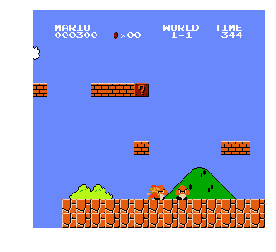

In [34]:
curious_mario_agent = CuriousActorCriticAgent(num_actions=mario_level_1.action_space.n, 
                                              checkpoint='models/curious_mario_agent_4M.tar')
curious_mario_agent.play(mario_level_1, max_games=5, max_steps=1000, recorder=recorder_1)

In [35]:
recorder_1.replay()

{'game': 1, 'reward': 9.066666666666666, 'game_duration': 19}
{'game': 2, 'reward': 9.066666666666666, 'game_duration': 19}
{'game': 3, 'reward': 24.666666666666686, 'game_duration': 283}
{'game': 4, 'reward': 9.066666666666666, 'game_duration': 19}
{'game': 5, 'reward': 9.066666666666666, 'game_duration': 19}
{'game': 6, 'reward': 9.066666666666666, 'game_duration': 19}
{'game': 7, 'reward': 38.73333333333332, 'game_duration': 201}
{'game': 8, 'reward': 39.66666666666666, 'game_duration': 119}
{'game': 9, 'reward': 38.06666666666663, 'game_duration': 229}
{'game': 10, 'reward': 40.066666666666656, 'game_duration': 86}
Preparing the animation...
{'game': 1, 'reward': 52.66666666666666, 'game_duration': 149}
{'game': 2, 'reward': 8.533333333333333, 'game_duration': 21}
{'game': 3, 'reward': 6.733333333333335, 'game_duration': 31}
{'game': 4, 'reward': 7.666666666666667, 'game_duration': 25}
{'game': 5, 'reward': 8.0, 'game_duration': 23}
{'game': 6, 'reward': 35.79999999999999, 'game_du

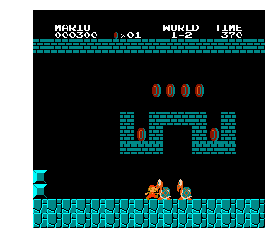

In [36]:
smart_mario_agent = ActorCriticAgent(num_actions=mario_level_1.action_space.n, 
                                     checkpoint='models/smart_mario_agent_4M.tar')
smart_mario_agent.play(mario_level_2, max_games=10, max_steps=5000, recorder=recorder_1, train=True)

curious_mario_agent = CuriousActorCriticAgent(num_actions=mario_level_1.action_space.n, 
                                              checkpoint='models/curious_mario_agent_4M.tar')
curious_mario_agent.play(mario_level_2, max_games=10, max_steps=5000, recorder=recorder_2, train=True)


In [37]:
recorder_1.replay()

In [38]:
recorder_2.replay()